In [1]:
!sudo pip install catboost plotly

Password:


[Данные](https://yadi.sk/d/CBoVCVIxJ2q2cw)

# Обработка лидарных данных
## Сегментация

### Про лидар

![](https://realnoevremya.com/uploads/gallery/b9/7e/35d10da899958110.jpg)

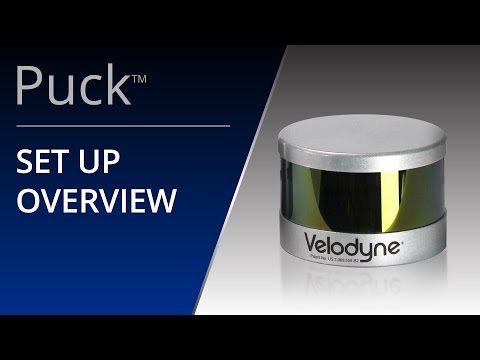

In [1]:
from IPython.lib.display import YouTubeVideo
YouTubeVideo('Pa-q5elS_nE')

## А что за данные на самом деле


In [1]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt

import plotly.offline as py
import plotly.figure_factory as ff
import plotly.graph_objs as go
import tqdm
py.init_notebook_mode(connected=True)

EQUAL_ASPECT_RATIO_LAYOUT = dict(
    margin={
        'l': 0,
        'r': 0,
        'b': 0,
        't': 0
    }, scene=dict(
    aspectmode='data'
))


def color(x, cmap='Reds'):
    cmap = plt.get_cmap(cmap)
    x = (x - np.min(x)) / np.max(x)
    
    return cmap(x)

%matplotlib inline

In [3]:
ds = pd.read_csv('./snow.csv')
ds = ds.set_index(['scene_id'])
ds.head()

,x,y,z,intensity,ring,label
scene_id,,,,,,
0,-11.355618,-4.206962,0.344085,0.0,23.0,1.0
0,-5.916535,-1.972164,0.283262,0.0,25.0,1.0
0,-7.410451,-2.113039,2.137792,0.0,31.0,1.0
0,-13.845870,-1.406652,0.406310,0.0,23.0,1.0
0,-8.326218,-0.346060,0.226469,0.0,22.0,1.0


* intensity - ???
* ring - ???

### Кольцо

![](https://eckop.com/wp-content/uploads/2018/07/LIDAR_02-1024x366.png)

In [4]:
scene = ds.loc[0]

fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)
fig.add_scatter3d(**{
    'x': scene.x,
    'y': scene.y,
    'z': scene.z,
    'mode': 'markers',
    'marker': {
        'size': 1,
        'color': color(scene.ring, 'tab20'),
    },
    'text': scene.ring
})

py.iplot(fig)


### Интенсивность

![](https://res.mdpi.com/sensors/sensors-15-28099/article_deploy/html/images/sensors-15-28099-g001-1024.png)

In [5]:
fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)
fig.add_scatter3d(**{
    'x': scene.x,
    'y': scene.y,
    'z': scene.z,
    'mode': 'markers',
    'marker': {
        'size': 1,
        'color': color(scene.intensity, 'seismic'),
    },
    'text': scene.intensity
})

py.iplot(fig)

In [6]:
scene = ds.loc[220]

# 199
# 205

fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)
fig.add_scatter3d(**{
    'x': scene.x,
    'y': scene.y,
    'z': scene.z,
    'mode': 'markers',
    'marker': {
        'size': 1,
        'color': color(scene.intensity, 'seismic'),
    },
    'text': scene.intensity
})

py.iplot(fig)


# Отфильтруем снег

## Эвристикой

In [7]:
def filter_by_intensity(intensity, limit=3):
    return intensity > limit

filtered_scene = scene[filter_by_intensity(scene.intensity)]


fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)
fig.add_scatter3d(**{
    'x': filtered_scene.x,
    'y': filtered_scene.y,
    'z': filtered_scene.z,
    'mode': 'markers',
    'marker': {
        'size': 1,
        'color': color(filtered_scene.intensity, 'seismic'),
    },
    'text': filtered_scene.intensity
})

py.iplot(fig)

Плохо и непонятно, будем учить

## Облачные вычисления

In [8]:
from sklearn.neighbors import KDTree

class ComputeFeatures(object):
    def __init__(self, r=1.0):
        self.xyz = None
        self.intensity = None
        self.ring = None
        self.index = None
        self.r = r

    def _feature_names(self):
        return ['x', 'y', 'z',
                'intensity',
                'avg_intensity',
                'nearest_dist',
#                 'avg_nearest_dist',
                'npoints',
                'ring',
                'nrings']
    
    def compute_avg_nearest_dist_feature(self, neighbours):
        dst = 0
        for p_id in neighbours:
            dists, _ = self.index.query(self.xyz[p_id][np.newaxis, :], k=3)
            dst += np.sum(dists)
        return dst / len(neighbours)
    
    def compute_point_features(self, point_id, neighbours):
        x = self.xyz[point_id][0]
        y = self.xyz[point_id][1]
        z = self.xyz[point_id][2]

        intensity = self.intensity[point_id]
        avg_intensity = sum(self.intensity[neighbours]) / len(neighbours)

        dists, _ = self.index.query(self.xyz[point_id][np.newaxis, :], k=3)
        nearest_dist = np.sum(dists)
#         avg_nearest_dist = self.compute_avg_nearest_dist_feature(neighbours)
        
        npoints = len(neighbours)
        ring = self.ring[point_id]
        
        rings = [self.ring[point_id]]
        for p in neighbours:
            rings.append(self.ring[p])
        nrings = len(set(rings))
        
        return [x, y, z, intensity, avg_intensity, nearest_dist, npoints, ring, nrings]
    
    def get_point_neighbours(self, point_id):
        return self.index.query_radius(self.xyz[point_id][np.newaxis, :], r=self.r)[0]
        
    def __call__(self, xyz, intensity, ring):
        self.xyz = xyz[:]
        self.intensity = intensity[:]
        self.ring = ring[:]
        
        self.index = KDTree(self.xyz)
        
        features = []
        for point_id in range(len(self.xyz)):
            neighbours = self.get_point_neighbours(point_id)
            features.append(self.compute_point_features(point_id, neighbours))
        
        return pd.DataFrame(columns=self._feature_names(), data=features)
    


In [9]:
ds_features = pd.read_csv('./features/snow_features.csv')
ds_features = ds_features.drop(["Unnamed: 0"], axis=1)
ds_features.shape

(7001791, 17)

In [10]:
features = ComputeFeatures(r=1.0)

for scene_id in tqdm.tqdm(ds.reset_index().scene_id.unique()):
    scene = ds.loc[scene_id]
    features_df = \
        features(scene[['x', 'y', 'z']].values, scene.intensity.values, scene.ring.values)
    features_df.to_csv('./features/{}.csv'.format(scene_id))

100%|██████████| 291/291 [40:23<00:00,  9.51s/it]   


In [11]:
features = []
for i in list(ds.reset_index().scene_id.unique()):
    feature = pd.read_csv('./features/{}.csv'.format(i))
    feature = feature.drop(["Unnamed: 0"], axis=1)
    feature['scene_id'] = i
    features.append(feature)
features = pd.concat(features)

features.head()

,x,y,z,intensity,avg_intensity,nearest_dist,npoints,ring,nrings,scene_id
0,-11.355618,-4.206962,0.344085,0.0,0.0,3.193396,1,23.0,1,0
1,-5.916535,-1.972164,0.283262,0.0,0.0,5.178412,1,25.0,1,0
2,-7.410451,-2.113039,2.137792,0.0,0.0,5.144911,1,31.0,1,0
3,-13.845870,-1.406652,0.406310,0.0,0.0,4.705295,1,23.0,1,0
4,-8.326218,-0.346060,0.226469,0.0,0.0,4.625732,1,22.0,1,0


In [12]:
features[:15]

,x,y,z,intensity,avg_intensity,nearest_dist,npoints,ring,nrings,scene_id
0,-11.355618,-4.206962,0.344085,0.0,0.000000,3.193396,1,23.0,1,0
1,-5.916535,-1.972164,0.283262,0.0,0.000000,5.178412,1,25.0,1,0
2,-7.410451,-2.113039,2.137792,0.0,0.000000,5.144911,1,31.0,1,0
3,-13.845870,-1.406652,0.406310,0.0,0.000000,4.705295,1,23.0,1,0
4,-8.326218,-0.346060,0.226469,0.0,0.000000,4.625732,1,22.0,1,0
5,-29.016968,-2.179385,0.945424,7.0,7.000000,7.050366,1,24.0,1,0
6,-2.074985,0.003017,0.044024,2.0,8.666667,0.901169,3,16.0,3,0
7,-2.041912,-0.009894,0.055311,3.0,8.666667,0.878293,3,17.0,3,0
8,-6.275961,0.790447,0.086301,0.0,0.000000,2.243166,2,19.0,2,0
9,-8.290426,1.923754,0.044705,0.0,0.000000,1.705733,2,18.0,2,0


# Посмотрим на разметку

In [13]:
scene = ds.loc[85]

fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)
fig.add_scatter3d(**{
    'x': scene.x,
    'y': scene.y,
    'z': scene.z,
    'mode': 'markers',
    'marker': {
        'size': 1,
        'color': color(scene.label, 'seismic'),
    },
    'text': scene.label
})

py.iplot(fig)

## Поучим что-нибудь

In [14]:
import random

random.seed(0)

ids = list(set(ds.index.values.tolist()))
random.shuffle(ids)

portions = [50, 20, 30]

assert sum(portions) == 100

nels = [int(len(ids) * p / 100) for p in portions]
nels[2] += len(ids) - sum(nels)

In [15]:
pos = 0
train_ids = ids[pos:nels[0]] # TODO train test split, but how. Random shuffle for now
pos += len(train_ids)
val_ids = ids[pos:(pos + nels[1])]
pos += len(val_ids)
test_ids = ids[pos:]

assert len(train_ids) + len(val_ids) + len(test_ids) == len(ids)

In [ ]:
# Of course, it's better to do stratified sampling, but smbdy is too lazy and besides, this one work well on test anyway

In [23]:
##### heuristic model

heu_X_test = ds[np.isin(ds.index, test_ids)].drop(['x', 'y', 'z', 'label'], axis=1)
heu_y_test = ds[np.isin(ds.index, test_ids)]['label']


##### my model

my_train = features[np.isin(features['scene_id'], train_ids)]
my_val = features[np.isin(features['scene_id'], val_ids)]
my_test = features[np.isin(features['scene_id'], test_ids)]

my_X_train = my_train.drop(['scene_id'], axis=1)
my_y_train = ds[np.isin(ds.index, train_ids)]['label']

my_X_val = my_val.drop(['scene_id'], axis=1)
my_y_val = ds[np.isin(ds.index, val_ids)]['label']

my_X_test = my_test.drop(['scene_id'], axis=1)
my_y_test = ds[np.isin(ds.index, test_ids)]['label']

##### reference model

ref_train = ds_features[np.isin(ds_features['scene_id'], train_ids)]
ref_val = ds_features[np.isin(ds_features['scene_id'], val_ids)]
ref_test = ds_features[np.isin(ds_features['scene_id'], test_ids)]

ref_X_train = ref_train.drop(['scene_id', 'label'], axis=1)
ref_y_train = ref_train['label']

ref_X_val = ref_val.drop(['scene_id', 'label'], axis=1)
ref_y_val = ref_val['label']

ref_X_test = ref_test.drop(['scene_id', 'label'], axis=1)
ref_y_test = ref_test['label']

In [17]:
import catboost

def learn(X_train, X_val, y_train, y_val):
    clf = catboost.CatBoostClassifier(n_estimators=100)
    clf.fit(
        X_train, y_train, early_stopping_rounds=10,
        use_best_model=True, eval_set=(X_val.values, y_val.values), plot=True, verbose=False)
    return clf

In [18]:
# del ds
my_cls = learn(my_X_train, my_X_val, my_y_train, my_y_val)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [19]:
ref_cls = learn(ref_X_train, ref_X_val, ref_y_train, ref_y_val)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

In [24]:
from sklearn.metrics import precision_recall_curve, precision_score, recall_score

def test_one(clf, X_test, y_test):
    y_test_hat = clf.predict_proba(X_test)
    pr, rec, thr = precision_recall_curve(y_test, y_test_hat[:, 1])
    ix = np.linspace(1, len(pr)-1, num=2000).astype(int)
    return pr[ix], rec[ix], thr[ix - 1]


def heuristic_filter_scoring():
    pr = []
    rec = []
    filter_range = list(range(1, 10))
    for i in filter_range:
        y_test_heuristic_hat = np.ones(len(heu_X_test))
        y_test_heuristic_hat[filter_by_intensity(heu_X_test.intensity, i)] = 0
        pr.append(precision_score(heu_y_test, y_test_heuristic_hat))
        rec.append(recall_score(heu_y_test, y_test_heuristic_hat))
        
    return pr, rec, filter_range

pr_bl, rec_bl, thr_bl = heuristic_filter_scoring()

def plot_pr_rec(*models):
    traces = []
    for model, clf, X_test, y_test in models:
        pr, rec, thr = test_one(clf, X_test, y_test)
        pr_rec = go.Scattergl(x = rec, y = pr, mode='lines', text=thr, name=model)
        traces.append(pr_rec)

    pr_rec_bl = go.Scatter(x = rec_bl, y = pr_bl, mode='lines+markers', text=thr_bl, name='Intensity BL')

    layout = go.Layout(
        title='Precission-recall',
        xaxis=dict(
            title='Recall'
        ),
        yaxis=dict(
            title='Precission'
        ))
    fig = go.Figure(
        data=traces + [pr_rec_bl],
        layout=layout)
    py.iplot(fig)
    
models = [('my classifier', my_cls, my_X_test, my_y_test), ('ref classifier', ref_cls, ref_X_test, ref_y_test)]
plot_pr_rec(*models)

In [ ]:
# Cool, our genious features seem to do quite good

# Повизуализируем

In [25]:
f_importances = list(zip(ref_cls.feature_names_, ref_cls.feature_importances_))
f_importances = sorted(f_importances, key=(lambda x: x[1]))
f_importances = list(zip(*f_importances))
f_importances

fig = go.Figure(go.Bar(
            x=f_importances[1],
            y=f_importances[0],
            orientation='h'))

fig.show()

In [26]:
f_importances = list(zip(my_cls.feature_names_, my_cls.feature_importances_))
f_importances = sorted(f_importances, key=(lambda x: x[1]))
f_importances = list(zip(*f_importances))
f_importances

fig = go.Figure(go.Bar(
            x=f_importances[1],
            y=f_importances[0],
            orientation='h'))

fig.show()

In [ ]:
# ^ Well, yes, it does seem quite strange, but I couldn't to find any mistakes... ^
# Maybe some feature interaction starts to kick in

In [27]:
list(set(my_test['scene_id']))

[0,
 7,
 16,
 20,
 23,
 27,
 31,
 36,
 37,
 47,
 48,
 50,
 51,
 52,
 56,
 61,
 62,
 71,
 73,
 74,
 75,
 77,
 81,
 83,
 85,
 104,
 111,
 113,
 114,
 125,
 126,
 128,
 130,
 132,
 133,
 138,
 139,
 140,
 141,
 144,
 145,
 150,
 152,
 154,
 155,
 156,
 158,
 160,
 161,
 169,
 171,
 180,
 181,
 183,
 186,
 197,
 200,
 204,
 205,
 207,
 208,
 211,
 215,
 222,
 224,
 226,
 227,
 232,
 234,
 240,
 241,
 244,
 245,
 248,
 253,
 255,
 258,
 261,
 264,
 265,
 272,
 275,
 278,
 279,
 282,
 286,
 288,
 289]

In [28]:
my_y_test_hat = my_cls.predict_proba(my_test.drop(['scene_id'], axis=1))

In [29]:
itest = my_test.set_index(['scene_id'])
itest['label'] = my_y_test

In [30]:
scene_id = 85
scene = itest.loc[scene_id]
scene_predictions = my_y_test_hat[my_test.scene_id == scene_id][:, 1]

errors = scene.loc[abs(scene.label - scene_predictions) >= 0.5]

In [31]:

fig = go.Figure(layout=EQUAL_ASPECT_RATIO_LAYOUT)

fig.add_scatter3d(**{
    'x': errors.x,
    'y': errors.y,
    'z': errors.z,
    'mode': 'markers',
    'marker': {
        'size': 1,
        'color': color(errors.label , 'seismic'),
    },
    'text': errors.label
})

py.iplot(fig)

/Users/dskravchenko/anaconda3/lib/python3.7/site-packages/matplotlib/colors.py:479: RuntimeWarning:

invalid value encountered in less

